# Imports

Cifar 100 is another classical image datasets.

In [1]:
from keras.datasets import cifar100 # this will get you the data!
import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from matplotlib.offsetbox import OffsetImage, AnnotationBbox

## Load the data

In [2]:
data = cifar100.load_data()

169001437/169001437 [==============================] - 3s 0us/step


In [3]:
(train_images, train_labels), (test_images, test_labels) = data

> To avoid problems later, we ensure they are float values between 0 and 1.

In [4]:
# normalizing the training data
train_images = train_images/255

> Plotting an example image from the data set.

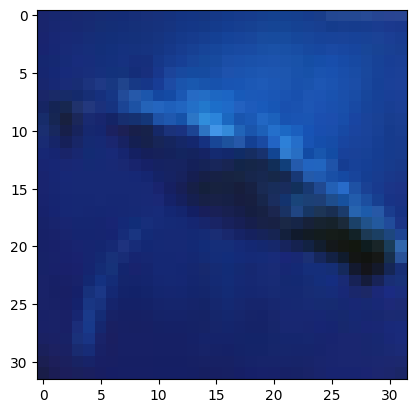

In [5]:
ind = 4311
plt.imshow(train_images[ind])
plt.show()

## Channels of an RGB image
An image has 3 channels corresponding to R,G,B.

Plotting each channel, of the example image above, separately using plt.imshow. It gives an idea about which channel contributes the most.

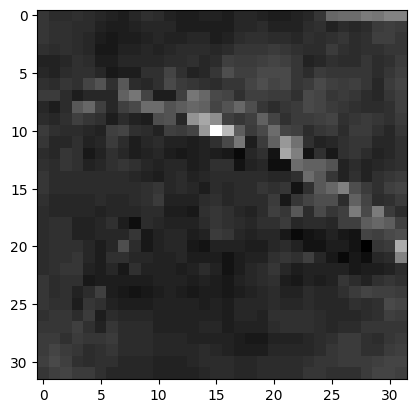

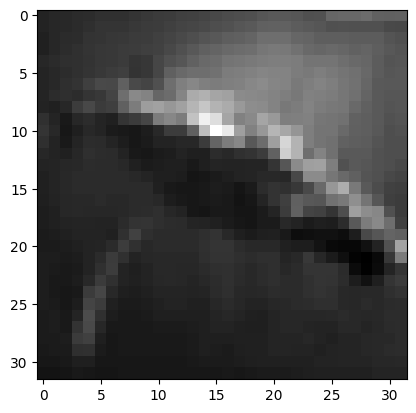

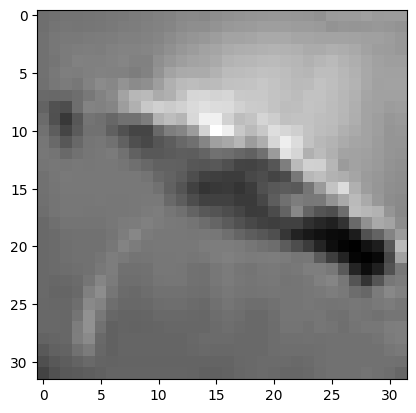

In [ ]:
for i in range(3):
  plt.imshow(train_images[ind][:,:,i], cmap='gray')
  plt.show()

We can think about an image as a vector in a high-dimensional vector space, $\mathbb{R}^d$.

We will write a python function which gives $k$ nearest vectors for a query image (in the sense of the Euclidean distance).  



In [ ]:
# function to plot an array of images in a row
def plot_images_in_a_row(ims):
  'Takes a list/array of images and plots them spaced horizontally.'
  _, axs = plt.subplots(1, len(ims), figsize = (20,5))
  for im, ax in zip(ims, axs.ravel()):
    ax.imshow(im)
    ax.axis('off')

In [ ]:
# finding k nearest neighbor of a query
def find_knn(query, samples, k):
  # creates an array with the distances from the query image to every other image
  distances = np.array([np.linalg.norm(query - sample) for sample in samples])
  # sorts the distances by values and return indices
  return np.argsort(distances)[:k]

[ 4311 22211 40296 10067 11289]


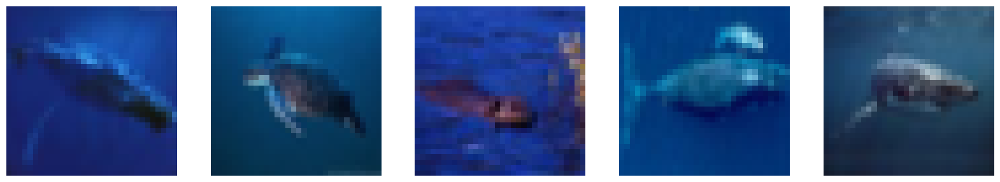

In [ ]:
# plotting the 10 nearest neighbor images of the given query image
indices = find_knn(train_images[ind], train_images, 5)
images = train_images[indices]
plot_images_in_a_row(images)
plt.show()

In [ ]:
# initializing tSNE
tsne = TSNE(n_components=2, perplexity=10, random_state=42, n_iter=2000)

Fit the model with cifar100 data and retreive the result.

In [ ]:
# reshaping the train images so that each image is a 32*32*3 = 3072 dimensional vector
train_images_flattened = train_images.reshape(train_images.shape[0], -1)
train_labels_flattened = train_labels.reshape(train_labels.shape[0], -1)
NUM_VECTORS = 10000 # to selct a smaller subset of images to fit tSNE faster
train_images_subset = train_images_flattened[:NUM_VECTORS]

In [ ]:
# fitting tsne on the data
train_images_subset_reduced = tsne.fit_transform(train_images_subset)

In [ ]:
assert train_images_subset_reduced.shape == (10000, 2)

## Plotting t-SNE embedding



In [ ]:
train_labels_subset = train_labels[:NUM_VECTORS] # getting the labels of the smaller subset of images on which tSNE is fit

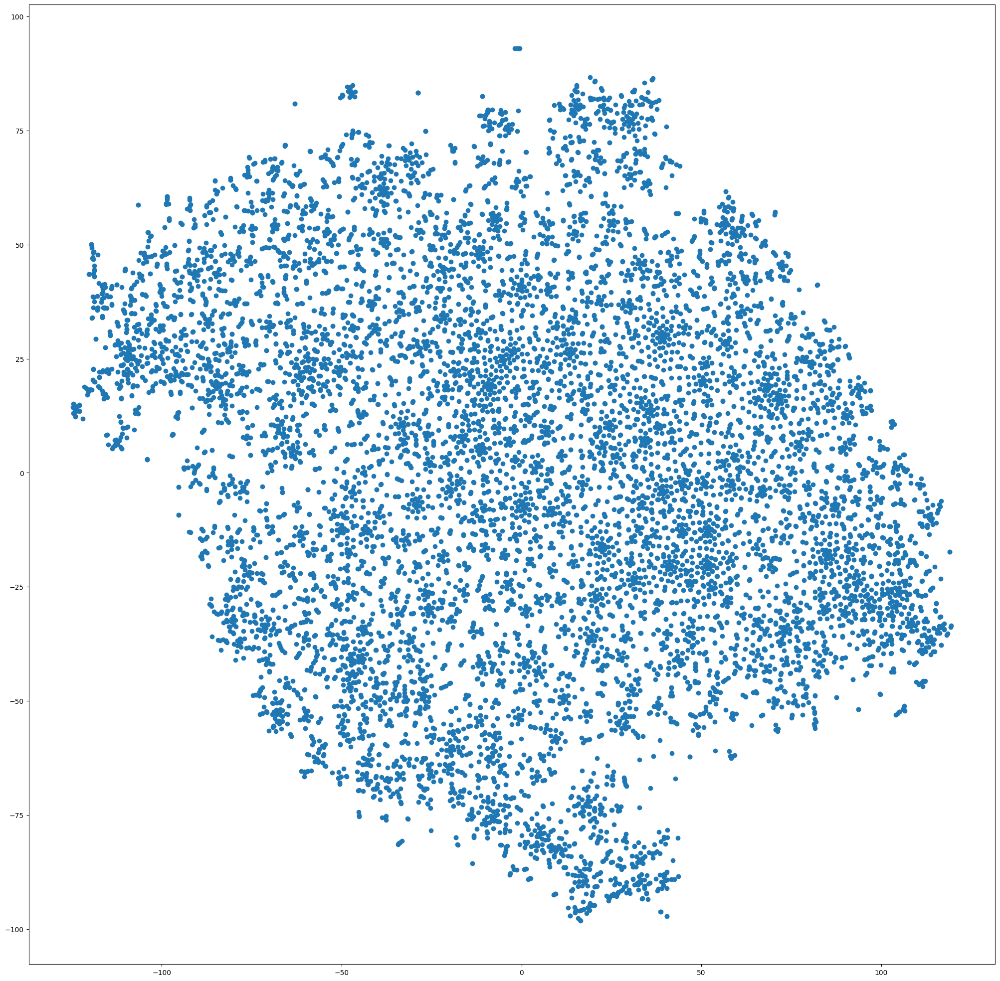

In [ ]:
plt.figure(figsize = (25,25)) # this will give you a nice big plot

plt.scatter(*train_images_subset_reduced.T)

Scatter-plot the output of tsne but this time assigning a color depending on the labels. Images with the same label will get the same color.


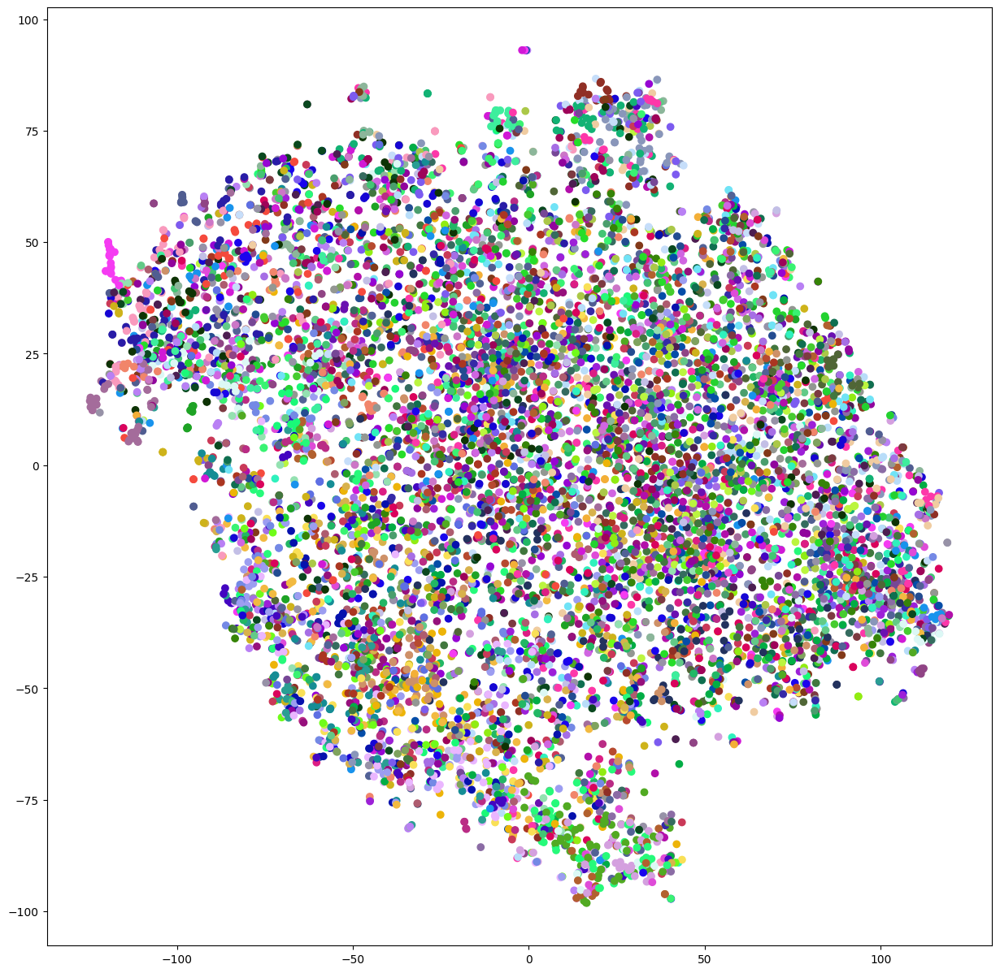

In [ ]:
np.random.seed(0) # to have reproducibility of the randomness
plt.figure(figsize = (15,15))
label_colors = np.random.random((100, 3)) # some random colors (RGB vectors)
colors = label_colors[train_labels_subset] # mapping the color to tSNE points
plt.scatter(*train_images_subset_reduced.T, c=colors)

## Plotting the images in t-SNE embedding space

In [ ]:
def plot_image_at_point(im, xy, zoom = 1):
  '''
  Plots a tiny image at point xy.
  '''
  dxy = np.random.rand(2)/100 * plt.ylim()
  plt.arrow(*xy, *dxy)
  ab = AnnotationBbox(OffsetImage(im, zoom=zoom, cmap = 'gray_r'), xy + dxy, frameon=False)
  plt.gca().add_artist(ab)

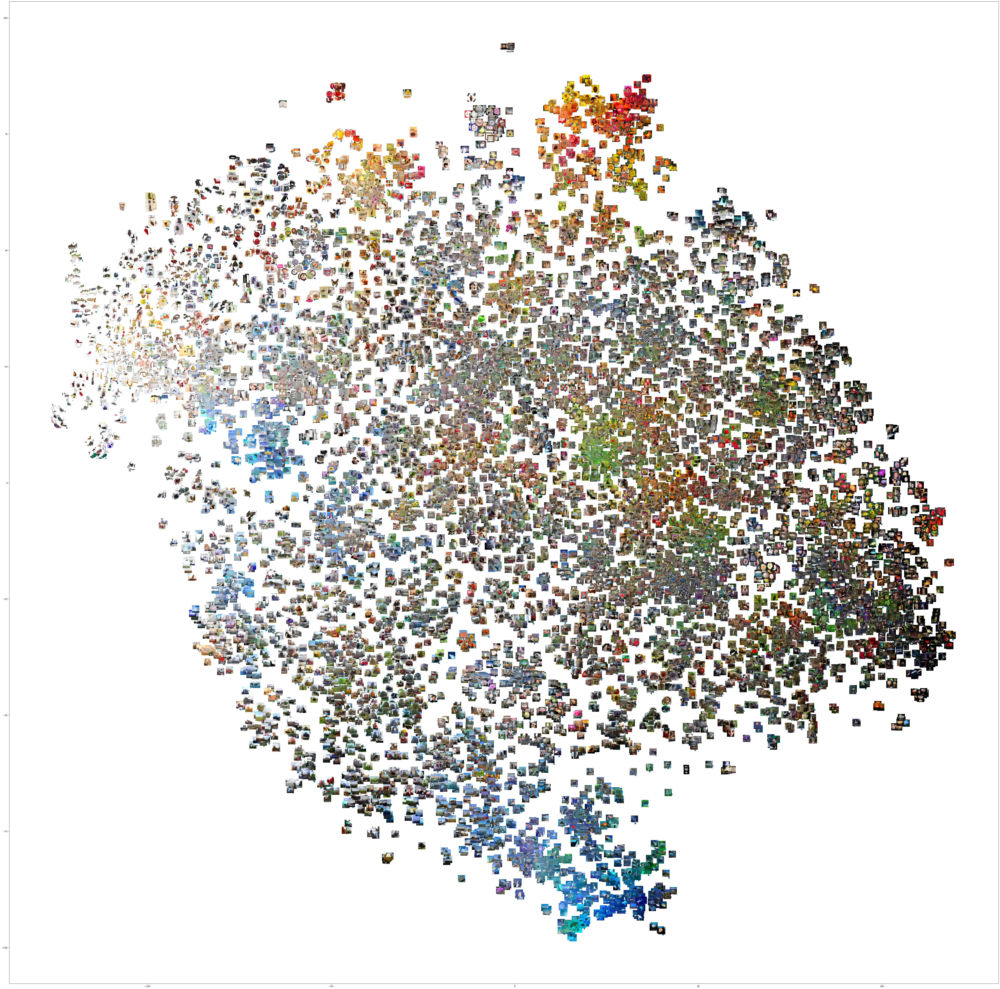

In [ ]:
np.random.seed(0)
plt.figure(figsize = (80,80)) # larger figure may be better
image_zoom = 1.0 # controls the size of plotted inmages

plt.scatter(*train_images_subset_reduced.T)
for im, xy in zip(train_images[:NUM_VECTORS], train_images_subset_reduced):
  plot_image_at_point(im, xy, image_zoom)

> Identifying 5 types of **patterns**
and select their
representative imagees using their tSNE coordinates.


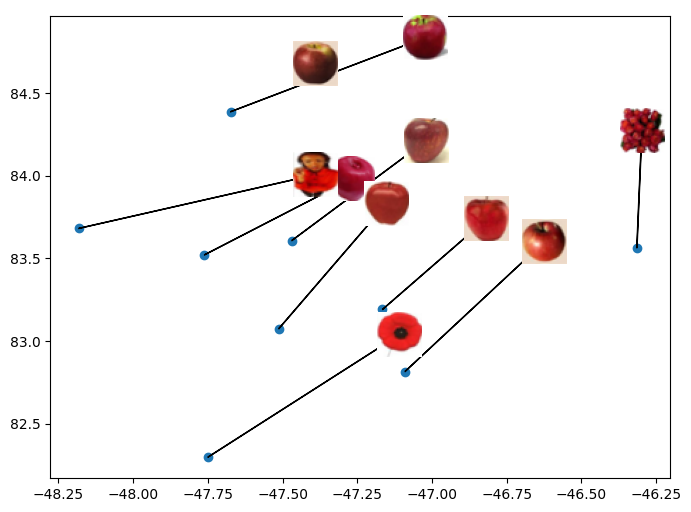

In [ ]:
# find an image in the tSNE that corresponds to apple

# Below is the code I ran to validate the coordinates where I located apple on the plot.
# I selected the points within the xy range where apple might be. It turns out that most of the point in that range correspond to apple.
# I plotted the images corresponding to those points and picked the first of the coordinates, and saved the index of the point corresponding the image
# I followed the same procedure for the remaining patterns

'''
points = []
indices = []
# eyeballing the tSNE coordinates
for point in train_images_subset_reduced:
  if -50 < point[0] < -45 and 80 < point[1] < 85:
    points.append(point)
    idx = find_knn(point, train_images_subset_reduced, 1)
    indices.append(idx[0])

print(points)
print(indices)
images = train_images[indices]
plot_images_in_a_row(images)
'''

# selected tSNE coordinate that corresponds to the pattern of apple on the plot
apple_coord = [-47.469166,  83.60747]
apple_idx = 658
# # find 10 closest points
k_points_indices = find_knn(apple_coord, train_images_subset_reduced, 10)
points = train_images_subset_reduced[k_points_indices]
# find the corresponding 10 images
images = train_images[k_points_indices]
# plotting the points
np.random.seed(0)
plt.figure(figsize = (8,6)) # larger figure may be better
image_zoom = 1.0 # controls the size of plotted inmages

plt.scatter(*points.T)
for im, xy in zip(images, points):
  plot_image_at_point(im, xy, image_zoom)



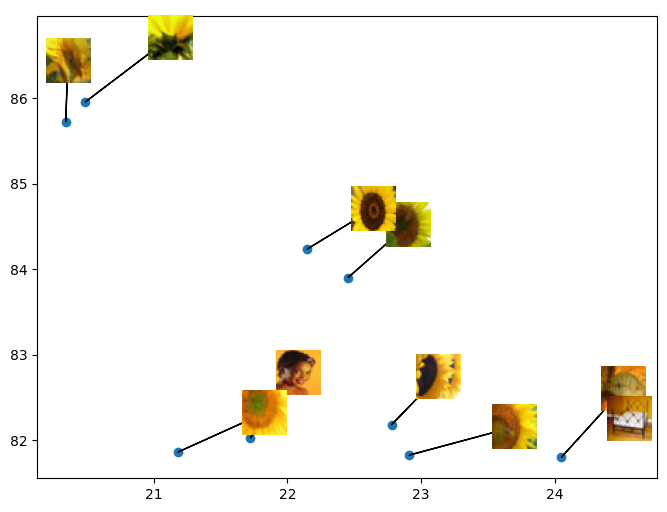

In [ ]:
'''
points = []
indices = []
# eyeballing the tSNE coordinates
for point in train_images_subset_reduced:
  if 20 < point[0] < 25 and 80 < point[1] < 90:
    points.append(point)
    idx = find_knn(point, train_images_subset_reduced, 1)
    indices.append(idx[0])

print(points)
print(indices)
images = train_images[indices]
plot_images_in_a_row(images)
'''


# selected tSNE coordinate that corresponds to the pattern of the sunflower spotted on the plot
sunflower_coord = [22.452015, 83.90036]
sunflower_idx = 362
# # find 10 closest points
k_points_indices = find_knn(sunflower_coord, train_images_subset_reduced, 10)
points = train_images_subset_reduced[k_points_indices]
# find the corresponding 10 images
images = train_images[k_points_indices]
# plotting the points
np.random.seed(0)
plt.figure(figsize = (8,6)) # larger figure may be better
image_zoom = 1.0 # controls the size of plotted inmages

plt.scatter(*points.T)
for im, xy in zip(images, points):
  plot_image_at_point(im, xy, image_zoom)



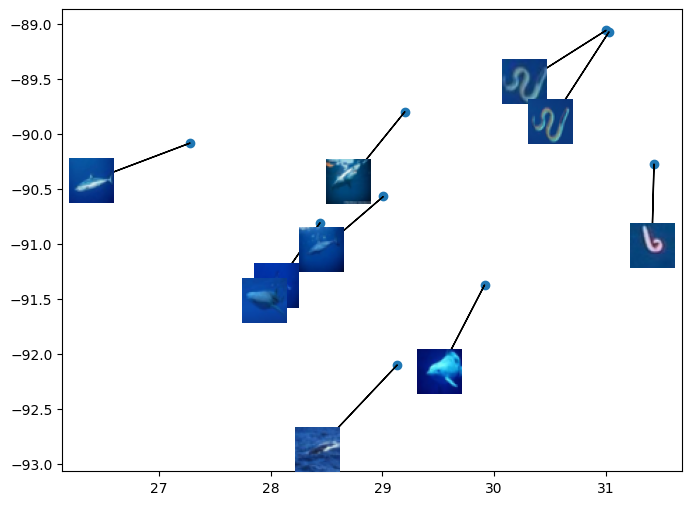

In [ ]:
# find an image in the tSNE that corresponds to sharks
'''
points = []
indices = []
# eyeballing the tSNE coordinates
for point in train_images_subset_reduced:
  if 25 < point[0] < 30 and -90 < point[1] < -85:
    points.append(point)
    idx = find_knn(point, train_images_subset_reduced, 1)
    indices.append(idx[0])

print(points)
print(indices)
images = train_images[indices]
plot_images_in_a_row(images)
'''

# selected tSNE coordinate that corresponds to the pattern of the shark spotted on the plot
shark_coord = [29.2023, -89.797325]
shark_idx = 335
# # find 10 closest points
k_points_indices = find_knn(shark_coord, train_images_subset_reduced, 10)
points = train_images_subset_reduced[k_points_indices]
# find the corresponding 10 images
images = train_images[k_points_indices]
# plotting the points
np.random.seed(0)
plt.figure(figsize = (8,6)) # larger figure may be better
image_zoom = 1.0 # controls the size of plotted inmages

plt.scatter(*points.T)
for im, xy in zip(images, points):
  plot_image_at_point(im, xy, image_zoom)

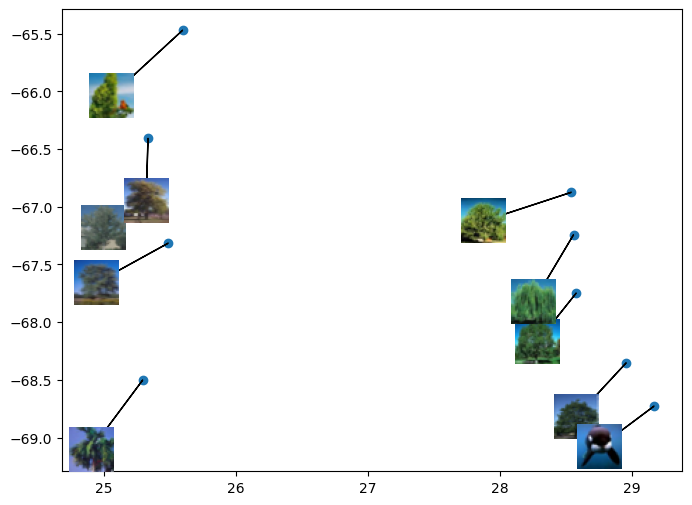

In [ ]:
# find an image in the tSNE that corresponds to oak tree
'''
points = []
indices = []
# eyeballing the tSNE coordinates
for point in train_images_subset_reduced:
  if 25 < point[0] < 30 and -70 < point[1] < -65:
    points.append(point)
    idx = find_knn(point, train_images_subset_reduced, 1)
    indices.append(idx[0])

print(points)
print(indices)
images = train_images[indices]
plot_images_in_a_row(images)
'''

# selected tSNE coordinate that corresponds to the pattern of the shark spotted on the plot
oak_coord = [28.957941, -68.35267]
oak_idx = 27
# find 10 closest points
k_points_indices = find_knn(oak_coord, train_images_subset_reduced, 10)
points = train_images_subset_reduced[k_points_indices]
# find the corresponding 10 images
images = train_images[k_points_indices]
# plotting the points
np.random.seed(0)
plt.figure(figsize = (8,6)) # larger figure may be better
image_zoom = 1.0 # controls the size of plotted inmages

plt.scatter(*points.T)
for im, xy in zip(images, points):
  plot_image_at_point(im, xy, image_zoom)

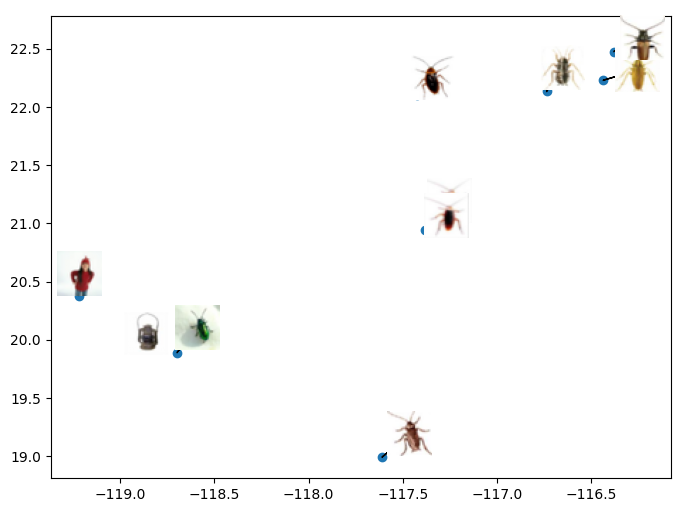

In [ ]:
# find an image in the tSNE that corresponds to beetle
'''
points = []
indices = []
# eyeballing the tSNE coordinates
for point in train_images_subset_reduced:
  if -120 < point[0] < -115 and 20 < point[1] < 25:
    points.append(point)
    idx = find_knn(point, train_images_subset_reduced, 1)
    indices.append(idx[0])

print(points)
print(indices)
images = train_images[indices]
plot_images_in_a_row(images)
'''

beetle_coord = [-117.356125, 21.035856]
beetle_idx = 1087
# find 10 closest points
k_points_indices = find_knn(beetle_coord, train_images_subset_reduced, 10)
points = train_images_subset_reduced[k_points_indices]
# find the corresponding 10 images
images = train_images[k_points_indices]
# plotting the points
np.random.seed(0)
plt.figure(figsize = (8,6)) # larger figure may be better
image_zoom = 1.0 # controls the size of plotted inmages

plt.scatter(*points.T)
for im, xy in zip(images, points):
  plot_image_at_point(im, xy, image_zoom)

## Back to the high dimensional space!

Picking a representative image for each of the 5 **patterns**, and finding 10 images which are closest *in the original high-dimensional space*.

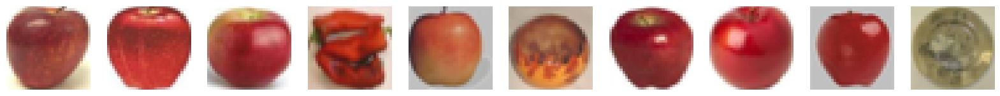

In [ ]:
# apple
apple_image = train_images[apple_idx]
ten_nearest_indices = find_knn(apple_image, train_images, 10)
ten_images = train_images[ten_nearest_indices]
plot_images_in_a_row(ten_images)
plt.show()

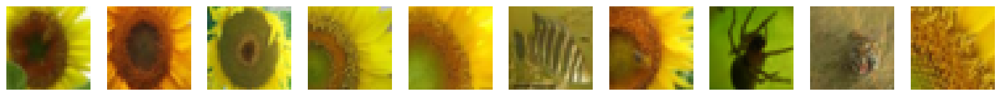

In [ ]:
# sunflower
sunflower_image = train_images[sunflower_idx]
ten_nearest_indices = find_knn(sunflower_image, train_images, 10)
ten_images = train_images[ten_nearest_indices]
plot_images_in_a_row(ten_images)
plt.show()

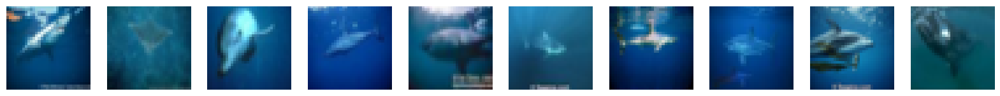

In [ ]:
# shark
shark_image = train_images[shark_idx]
ten_nearest_indices = find_knn(shark_image, train_images, 10)
ten_images = train_images[ten_nearest_indices]
plot_images_in_a_row(ten_images)
plt.show()

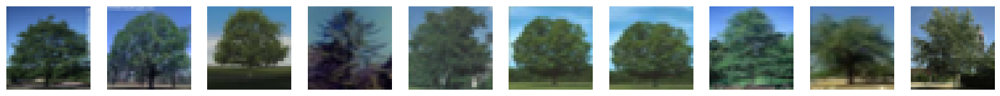

In [ ]:
# oak
oak_image = train_images[oak_idx]
ten_nearest_indices = find_knn(oak_image, train_images, 10)
ten_images = train_images[ten_nearest_indices]
plot_images_in_a_row(ten_images)
plt.show()

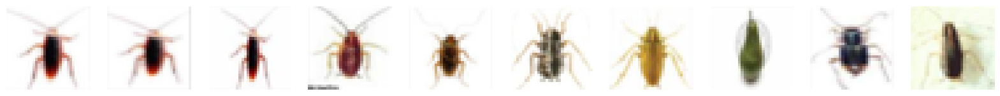

In [ ]:
# beetle
beetle_image = train_images[beetle_idx]
ten_nearest_indices = find_knn(beetle_image, train_images, 10)
ten_images = train_images[ten_nearest_indices]
plot_images_in_a_row(ten_images)
plt.show()

# Clustering with k-Means



I think K = 20 is a good number for clusters.

In [ ]:
from sklearn.cluster import MiniBatchKMeans

In [ ]:
k = 20
mini_batch_kmeans = MiniBatchKMeans(n_clusters=k, batch_size=100, max_iter=100)

Fitting kMeans with your data.

In [ ]:
mini_batch_kmeans.fit(train_images[:NUM_VECTORS].reshape(train_images[:NUM_VECTORS].shape[0], -1))

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


MiniBatchKMeans(batch_size=100, n_clusters=20)

## Plotting tSNE embedding using clusters' labels

Plotting the tSNE embedding again -- but this time assigning
colors corresponding to the kMeans cluster of each image.

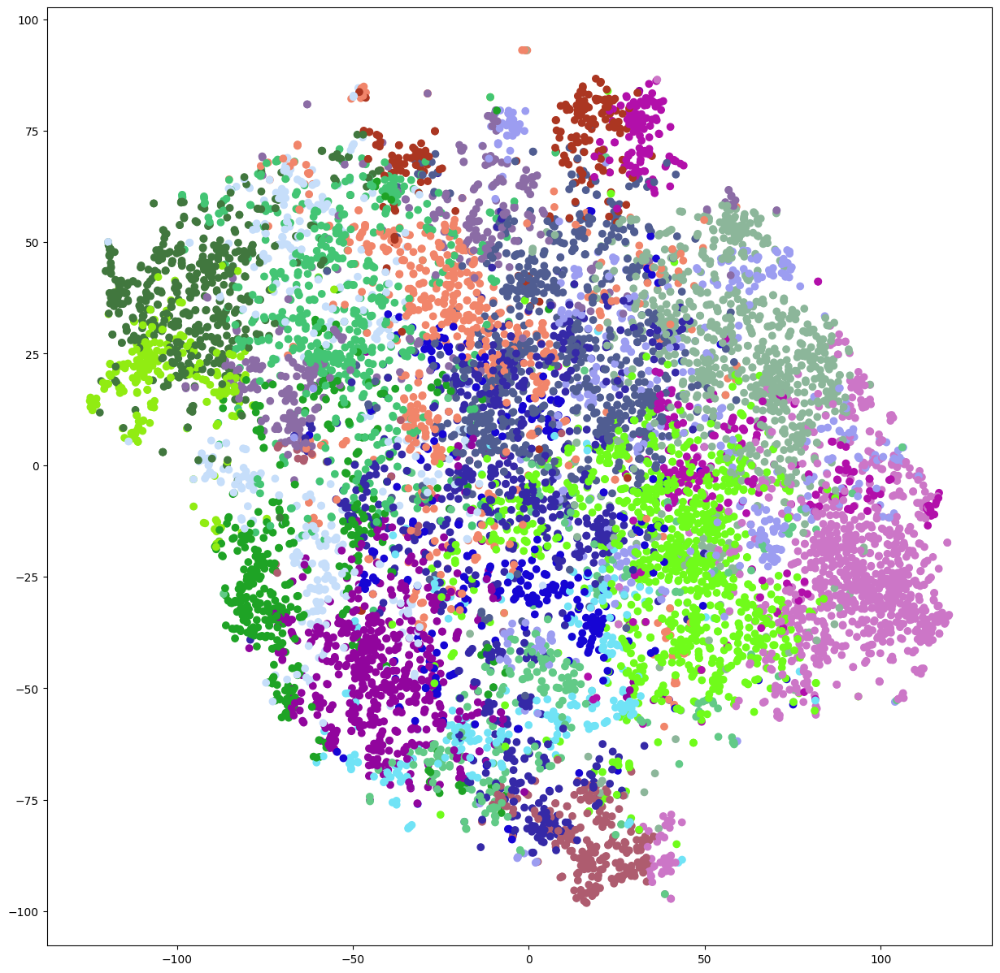

In [ ]:
# ...
np.random.seed(0)

cluster_assignments = mini_batch_kmeans.labels_
label_colors = np.random.random((100, 3)) # some random colors (RGB vectors)
colors = label_colors[cluster_assignments[:NUM_VECTORS]]

plt.figure(figsize = (15,15))
plt.scatter(*train_images_subset_reduced.T, c=colors)

We see significant groups of points with the same color. It's very difficult to count, but I think there are roughly 25 to 30 significant groups.

Repeating the plot above but defining the color of each point as the mean color of the images in the cluster to which the image belongs to.

In [ ]:
cluster_assignments_subset = cluster_assignments[:NUM_VECTORS]
# Calculate mean colors for each cluster
mean_images = []
for i in range(k):
  cluster_images = train_images_subset[cluster_assignments_subset == i]
  mean_image = np.mean(cluster_images, axis=0)
  mean_images.append(mean_image)

mean_images = np.array(mean_images)
mean_colors = []

for mean_image in mean_images:
  rgb = [np.mean(mean_image[:1024]), np.mean(mean_image[1024:2048]), np.mean(mean_image[2048:3072])]
  mean_colors.append(rgb)




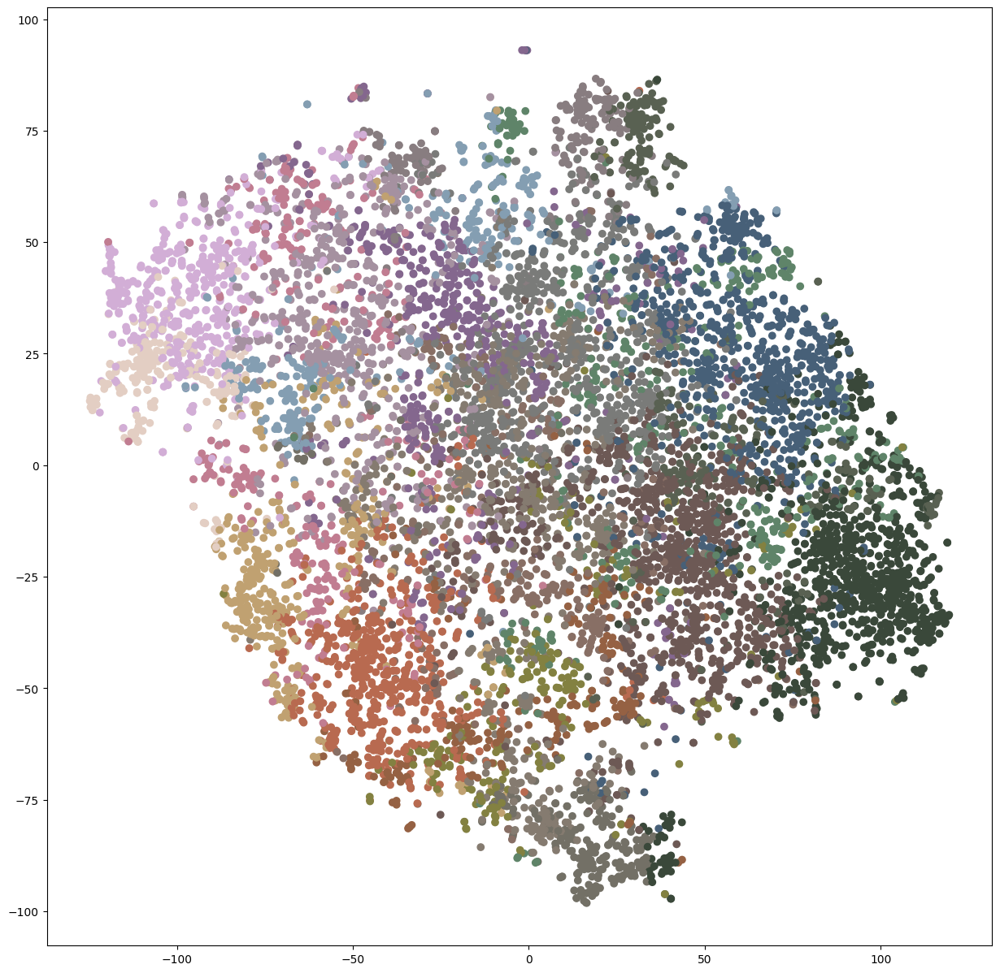

In [ ]:
label_colors = np.array(mean_colors)
colors = label_colors[cluster_assignments[:NUM_VECTORS]]

plt.figure(figsize = (15,15))
plt.scatter(*train_images_subset_reduced.T, c=colors)


## kMeans on the entire dataset

In [ ]:
mini_batch_kmeans.fit(train_images_flattened)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


MiniBatchKMeans(batch_size=100, n_clusters=20)

Veriifying if the clusters we got on the entire dataset are reasonable.

For each cluster center, we plot 10 images which are closest in the sense of the Euclidean metric to it.

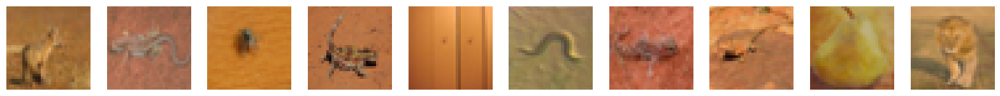

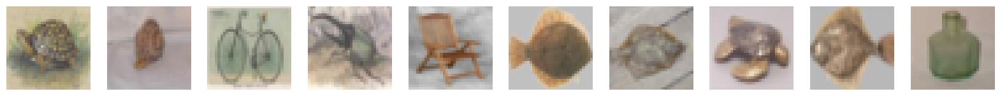

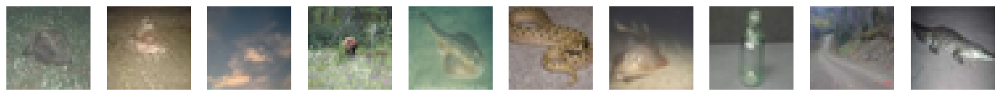

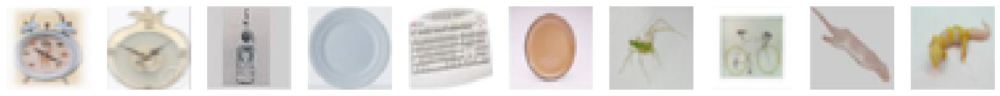

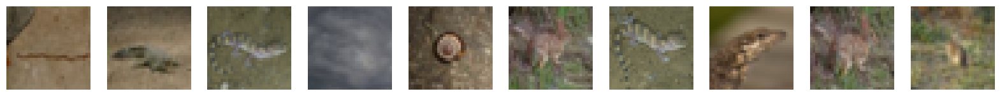

...

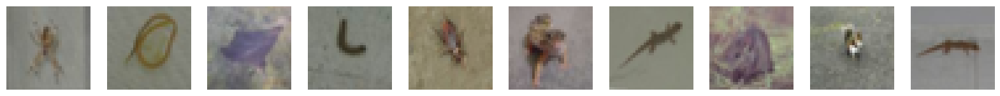

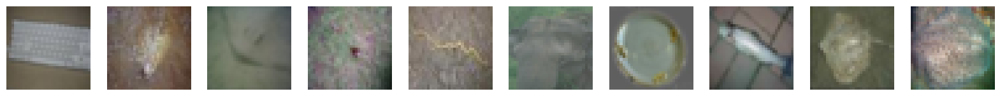

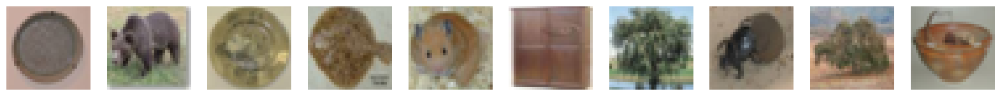

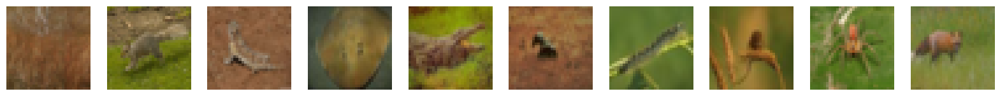

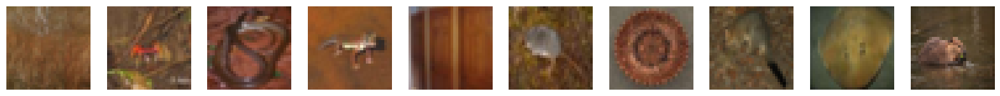

In [ ]:
cluster_centers = mini_batch_kmeans.cluster_centers_
for cluster_center in cluster_centers:
  indices = find_knn(cluster_center, train_images_flattened, 10)
  images = train_images[indices]
  plot_images_in_a_row(images)